<a href="https://colab.research.google.com/github/partho2001/face_landmark_/blob/main/face_landmark.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install dlib opencv-python


--2023-12-12 14:02:52--  http://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2
Resolving dlib.net (dlib.net)... 107.180.26.78
Connecting to dlib.net (dlib.net)|107.180.26.78|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 64040097 (61M)
Saving to: ‘shape_predictor_68_face_landmarks.dat.bz2’

shape_predictor_68_ 100%[===================>]  61.07M   125MB/s    in 0.5s    

2023-12-12 14:02:53 (125 MB/s) - ‘shape_predictor_68_face_landmarks.dat.bz2’ saved [64040097/64040097]



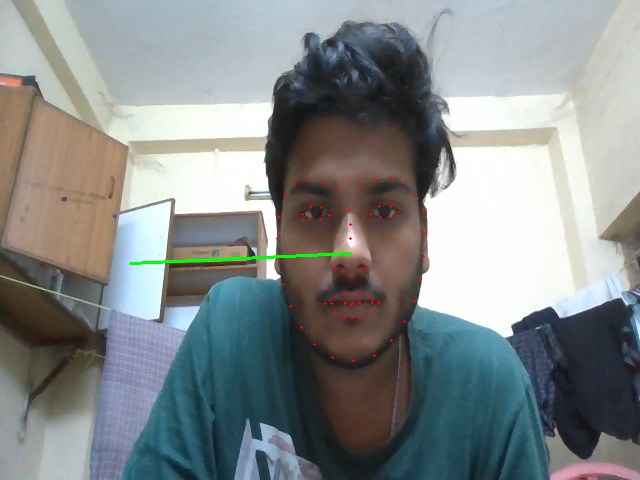

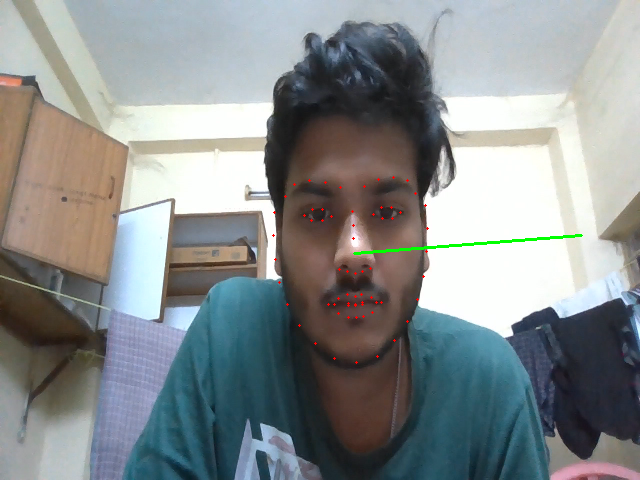

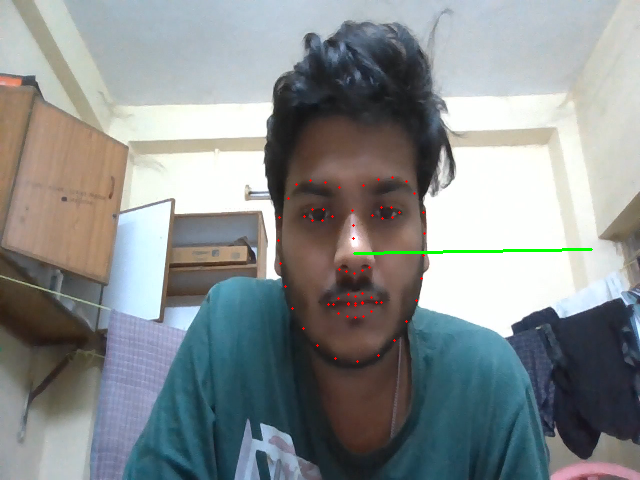

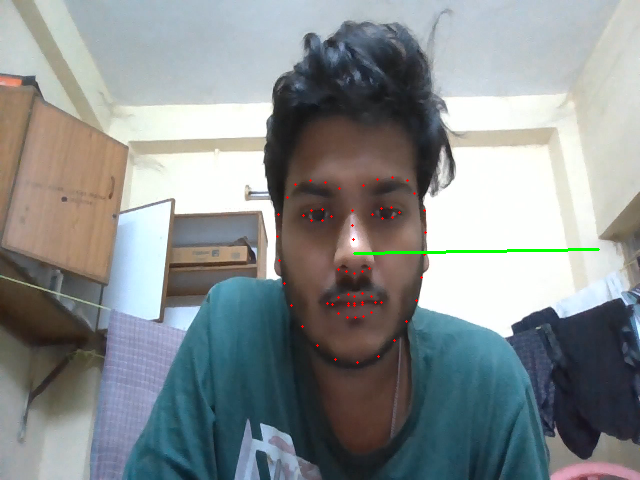

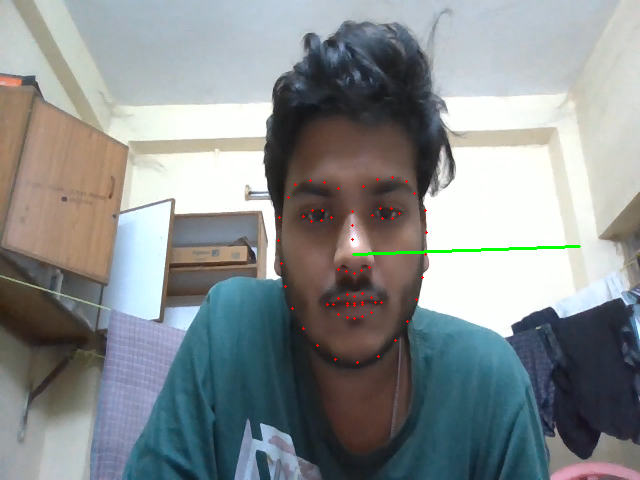

...

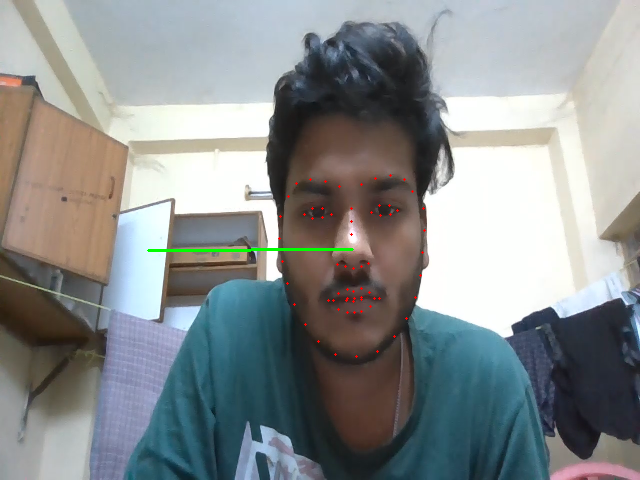

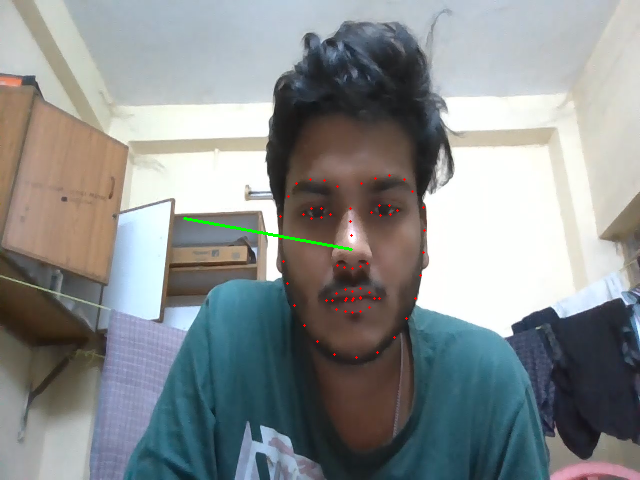

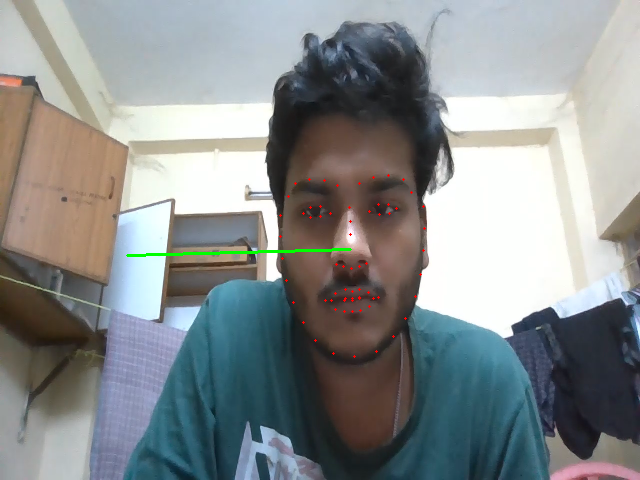

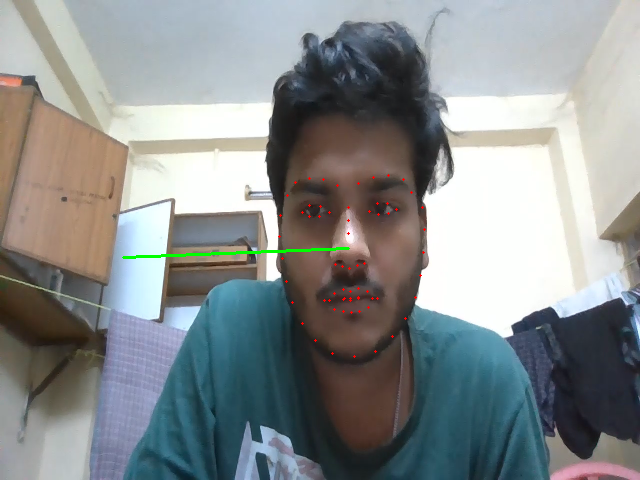

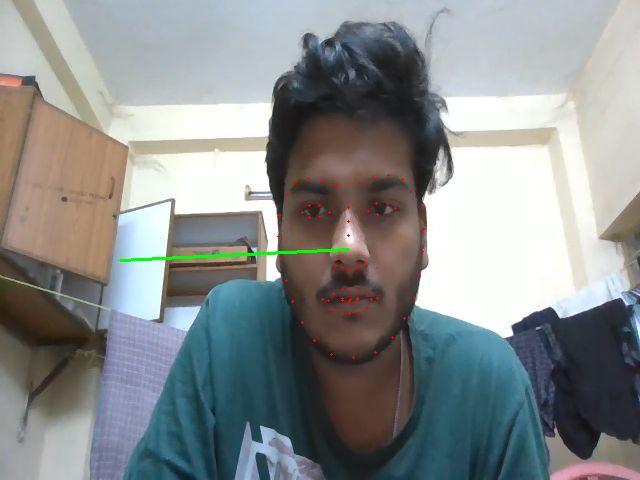

In [20]:
# Install the required libraries
!pip install opencv-python numpy

# Use JavaScript to access the webcam and send frames to Python
from IPython.display import display, Javascript
from google.colab.output import eval_js
import cv2
import dlib
import numpy as np
from imutils import face_utils
from google.colab.patches import cv2_imshow

# Download the facial landmark predictor file
!wget http://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2
!bzip2 -dk shape_predictor_68_face_landmarks.dat.bz2

# Load the pre-trained facial landmark predictor
predictor_path = "shape_predictor_68_face_landmarks.dat"
detector = dlib.get_frontal_face_detector()
predictor = dlib.shape_predictor(predictor_path)

# Function to perform head pose estimation
def estimate_head_pose(shape, frame):
    # Head pose estimation (example using a simple approach)
    image_points = np.array([
        shape[30],  # Nose tip
        shape[8],   # Chin
        shape[45],  # Right eye left corner
        shape[36],  # Left eye right corner
        shape[54],  # Right mouth corner
        shape[48]   # Left mouth corner
    ], dtype="double")

    # Camera parameters (example values)
    focal_length = frame.shape[1]
    center = (frame.shape[1] // 2, frame.shape[0] // 2)
    camera_matrix = np.array([[focal_length, 0, center[0]],
                              [0, focal_length, center[1]],
                              [0, 0, 1]], dtype="double")

    # Simple head pose estimation
    model_points = np.array([
        (0.0, 0.0, 0.0),             # Nose tip
        (0.0, -330.0, -65.0),        # Chin
        (-225.0, 170.0, -135.0),      # Right eye left corner
        (225.0, 170.0, -135.0),       # Left eye right corner
        (-150.0, -150.0, -125.0),     # Right mouth corner
        (150.0, -150.0, -125.0)       # Left mouth corner
    ])

    # Solve the PnP problem
    _, rotation_vector, translation_vector = cv2.solvePnP(model_points, image_points, camera_matrix, None, flags=cv2.SOLVEPNP_ITERATIVE)

    # Project the 3D points to image plane
    (nose_end_point2D, _) = cv2.projectPoints(np.array([(0.0, 0.0, 1000.0)]), rotation_vector, translation_vector, camera_matrix, distCoeffs=None)

    # Draw the line representing the head pose
    p1 = (int(image_points[0][0]), int(image_points[0][1]))
    p2 = (int(nose_end_point2D[0][0][0]), int(nose_end_point2D[0][0][1]))
    cv2.line(frame, p1, p2, (0, 255, 0), 2)

# Read video from the uploaded file
video_file_name = "/content/WIN_20231212_19_31_28_Pro.mp4"
cap = cv2.VideoCapture(video_file_name)

while cap.isOpened():
    # Capture a frame from the video
    ret, frame = cap.read()

    # Break the loop if the video is finished
    if not ret:
        break

    # Resize the frame for better performance
    frame = cv2.resize(frame, (640, 480))

    # Detect faces in the frame
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    faces = detector(gray)

    for face in faces:
        # Get facial landmarks
        shape = predictor(gray, face)
        shape = face_utils.shape_to_np(shape)

        # Draw the facial landmarks on the frame
        for (x, y) in shape:
            cv2.circle(frame, (x, y), 1, (0, 0, 255), -1)

        # Perform head pose estimation
        estimate_head_pose(shape, frame)

    # Display the frame
    cv2_imshow(frame)

    # Break the loop if 'q' key is pressed
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release the video capture
cap.release()

# Close all OpenCV windows
cv2.destroyAllWindows()
